In [1]:
import sys
sys.path.append('/ix/djishnu/alw399/SpaceOracle/src/Banksy_py')
import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [3]:
from banksy_utils.load_data import load_adata, display_adata

In [4]:
adata = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_visiumHD_subsampled.h5ad')
adata

AnnData object with n_obs × n_vars = 10000 × 3058
    obs: 'ct3', 'cell_type'
    obsm: 'X_pca', 'X_umap', 'spatial'
    layers: 'imputed_count', 'normalized_count', 'raw_count'

In [5]:
raw_x, raw_y = adata.obsm['spatial'][:, 0], adata.obsm['spatial'][:, 1]

In [6]:
from banksy.main import median_dist_to_nearest_neighbour

In [ ]:
plot_graph_weights = True
k_geom = 15 # number of spatial neighbours
max_m = 1 # use both mean and AFT
nbr_weight_decay = "scaled_gaussian" # can also choose "reciprocal", "uniform" or "ranked"

# Find median distance to closest neighbours
nbrs = median_dist_to_nearest_neighbour(adata, key = 'spatial')


Median distance to closest cell = 92.80942788800753

---- Ran median_dist_to_nearest_neighbour in 0.03 s ----



In [8]:
adata.obs['x'] = raw_x
adata.obs['y'] = raw_y


Median distance to closest cell = 92.80942788800753

---- Ran median_dist_to_nearest_neighbour in 0.02 s ----

---- Ran generate_spatial_distance_graph in 0.05 s ----

---- Ran row_normalize in 0.03 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.34 s ----

----- Plotting Edge Histograms for m = 0 -----

Edge weights (distances between cells): median = 304.1901460900814, mode = 318.8565116098286

---- Ran plot_edge_histogram in 0.08 s ----


Edge weights (weights between cells): median = 0.05770565534957245, mode = 0.034438735832702475

---- Ran plot_edge_histogram in 0.06 s ----

---- Ran generate_spatial_distance_graph in 0.08 s ----

---- Ran theta_from_spatial_graph in 0.14 s ----

---- Ran row_normalize in 0.04 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.54 s ----

----- Plotting Edge Histograms for m = 1 -----

Edge weights (distances between cells): median = 432.9067884640275, mode = 442.3052454679758

---- Ran plot_edge_histogram in 0.06 s ----


Edge w

/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/numpy/lib/histograms.py:841: ComplexWarning: Casting complex values to real discards the imaginary part
  indices = f_indices.astype(np.intp)
/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/axes/_axes.py:7004: ComplexWarning: Casting complex values to real discards the imaginary part
  bins = np.array(bins, float)  # causes problems if float16
/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


Maximum weight: 0.20257391085350612

---- Ran plot_graph_weights in 3.55 s ----

Maximum weight: (0.09307302599616853-0.005817671728610923j)

---- Ran plot_graph_weights in 5.93 s ----

----- Plotting theta Graph -----


/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/collections.py:426: ComplexWarning: Casting complex values to real discards the imaginary part
  renderer.draw_path_collection(


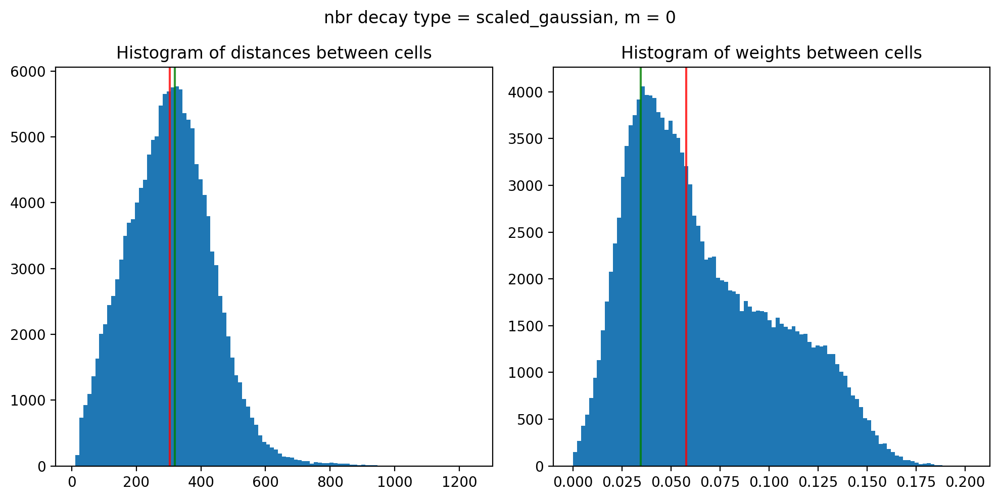

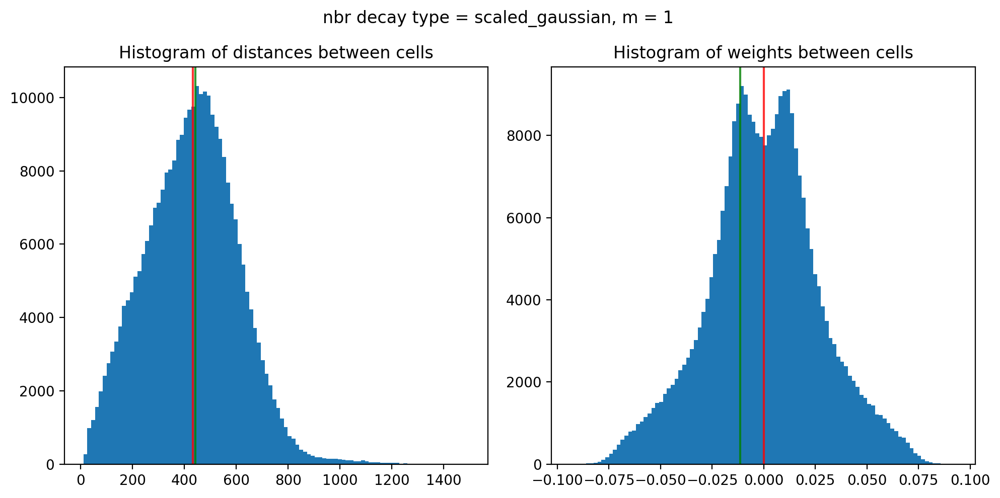

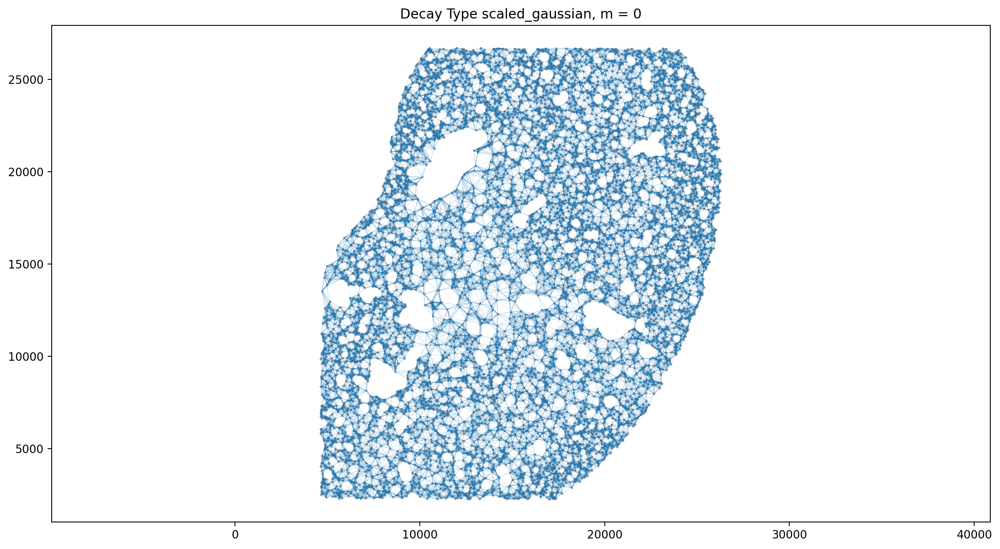

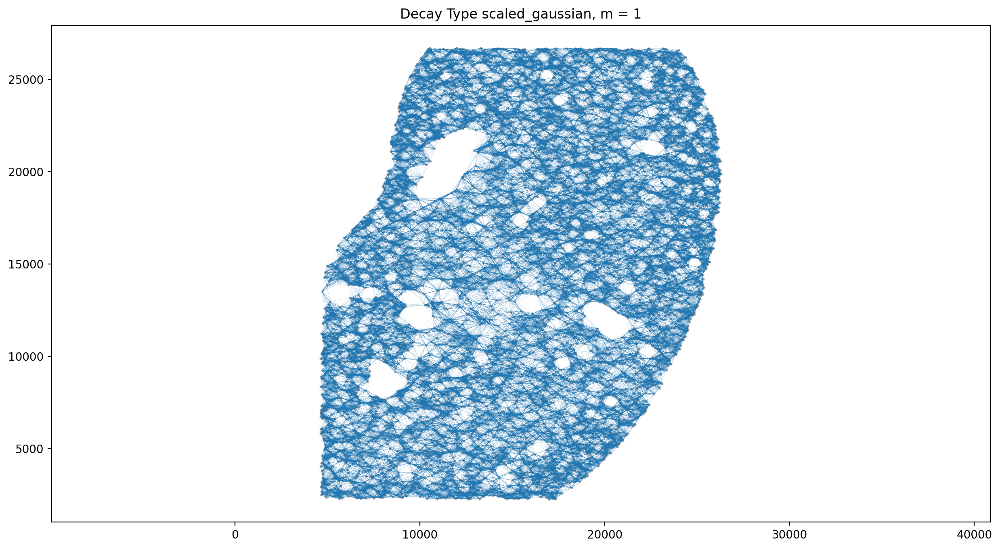

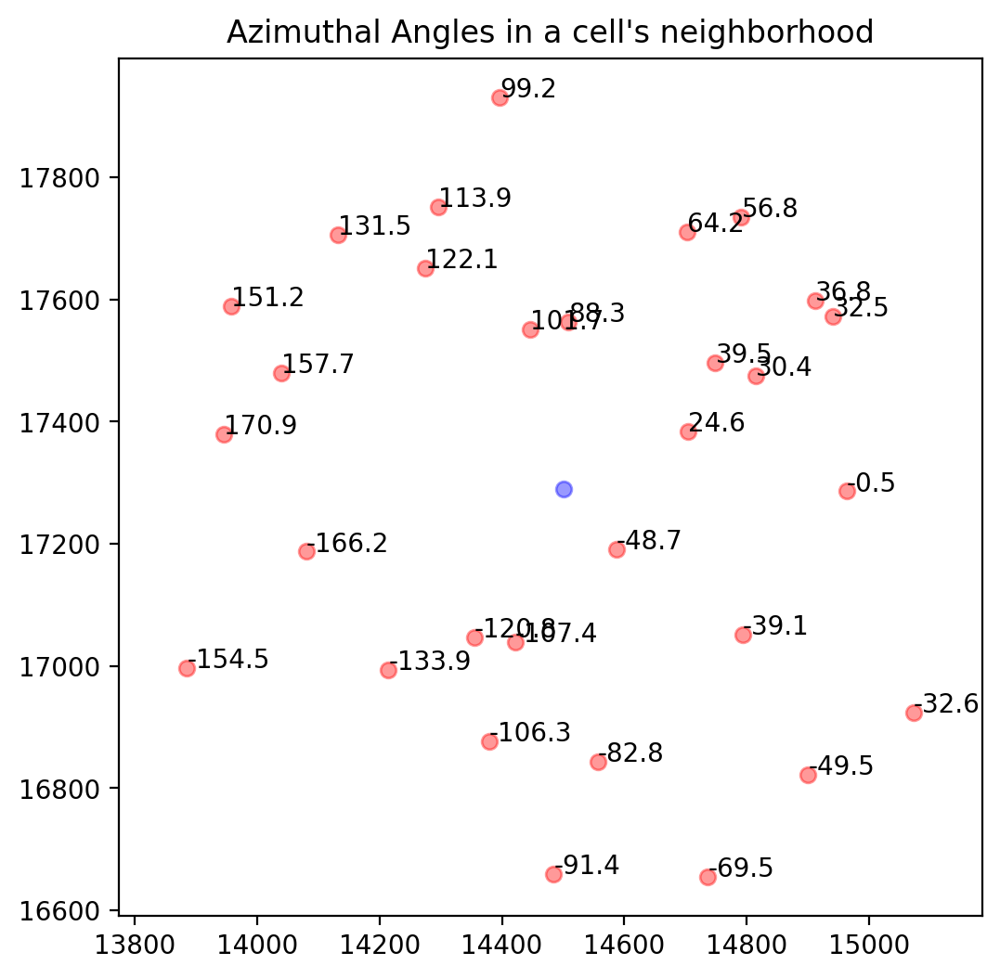

In [9]:
from banksy.initialize_banksy import initialize_banksy

banksy_dict = initialize_banksy(
    adata,
    ('x', 'y', 'spatial'),
    k_geom,
    nbr_weight_decay=nbr_weight_decay,
    max_m=max_m,
    plt_edge_hist=True,
    plt_nbr_weights=True,
    plt_agf_angles=False, # takes long time to plot
    plt_theta=True,
)

In [10]:
from banksy.embed_banksy import generate_banksy_matrix

# The following are the main hyperparameters for BANKSY
# -----------------------------------------------------
# resolutions = [0.6]  # clustering resolution for UMAP
resolutions = [1.5]
pca_dims = [50]  # Dimensionality in which PCA reduces to
lambda_list = [0.1]  # list of lambda parameters

banksy_dict, banksy_matrix = generate_banksy_matrix(adata,
                                                    banksy_dict,
                                                    lambda_list,
                                                    max_m)
banksy_matrix

Runtime Apr-15-2025-10-03

3058 genes to be analysed:
Gene List:
Index(['A1bg', 'A4galt', 'Aadac', 'Aadat', 'Aak1', 'Abat', 'Abca1', 'Abca13',
       'Abca7', 'Abca8a',
       ...
       'Zfyve28', 'Zfyve9', 'Zmynd15', 'Znrf1', 'Znrf3', 'Zranb3', 'Zswim7',
       'Zswim9', 'Zwilch', 'ccdc198'],
      dtype='object', length=3058)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <10000x10000 sparse matrix of type '<class 'numpy.float64'>'
	with 150000 stored elements in Compressed Sparse Row format>, 1: <10000x10000 sparse matrix of type '<class 'numpy.complex128'>'
	with 300000 stored elements in Compressed Sparse Row format>}}

Nbr matrix | Mean: 0.02 | Std: 0.22
Size of Nbr | Shape: (10000, 3058)
Top 3 entries of Nbr Mat:

[[0.         0.         0.        ]
 [0.         0.         0.        ]
 [0.         0.02367747 0.        ]]



AGF matrix | Mean: 0.01 | Std: 0.07
Size of AGF mat (m = 1) | Shape: (10000, 3058)
Top entries of AGF:
[[0.         0.         0.        ]
 [0.         0.         0.        ]
 [0.         0.02509377 0.02684221]]
Ran 'Create BANKSY Matrix' in 0.15 mins

Cell by gene matrix has shape (10000, 3058)

Scale factors squared: [0.9        0.06666667 0.03333333]
Scale factors: [0.9486833  0.25819889 0.18257419]


/ix/djishnu/alw399/SpaceOracle/src/Banksy_py/banksy/main.py:302: RuntimeWarning: invalid value encountered in divide
  zscored_matrix = (matrix - E_x) / np.sqrt(variance)


Shape of BANKSY matrix: (10000, 9174)
Type of banksy_matrix: <class 'anndata._core.anndata.AnnData'>



AnnData object with n_obs × n_vars = 10000 × 9174
    obs: 'ct3', 'cell_type', 'x', 'y'
    var: 'is_nbr', 'k'

In [13]:
outdir = '/ix/djishnu/shared/djishnu_kor11/banksy_outputs'
banksy_matrix.to_df().to_parquet(f'{outdir}/mouse_kidney_visiumHD_subsampled_embedding.parquet')

In [11]:
from banksy.main import concatenate_all

banksy_dict["nonspatial"] = {
    # Here we simply append the nonspatial matrix (adata.X) to obtain the nonspatial clustering results
    0.0: {"adata": concatenate_all([adata.X], 0, adata=adata), }
}

print(banksy_dict['nonspatial'][0.0]['adata'])

Scale factors squared: [1.]
Scale factors: [1.]


/ix/djishnu/alw399/SpaceOracle/src/Banksy_py/banksy/main.py:302: RuntimeWarning: invalid value encountered in divide
  zscored_matrix = (matrix - E_x) / np.sqrt(variance)


AnnData object with n_obs × n_vars = 10000 × 3058
    obs: 'ct3', 'cell_type', 'x', 'y'
    var: 'is_nbr', 'k'


In [19]:
import gc
gc.collect()

56661

In [18]:
from banksy_utils.umap_pca import pca_umap

pca_umap(
    banksy_dict,
    pca_dims = pca_dims,
    add_umap = True,
    plt_remaining_var = False,
)

Current decay types: ['scaled_gaussian', 'nonspatial']

Reducing dims of dataset in (Index = scaled_gaussian, lambda = 0.1)

Setting the total number of PC = 50
Original shape of matrix: (10000, 9174)
Reduced shape of matrix: (10000, 50)
------------------------------------------------------------
min_value = -120.49993557309634, mean = -6.684430786663142e-17, max = 198.43601160973176

Conducting UMAP and adding embeddings to adata.obsm["reduced_pc_50_umap"]
UMAP embedding
------------------------------------------------------------
shape: (10000, 2)


AxisArrays with keys: reduced_pc_50, reduced_pc_50_umap

Reducing dims of dataset in (Index = nonspatial, lambda = 0.0)

Setting the total number of PC = 50
Original shape of matrix: (10000, 3058)
Reduced shape of matrix: (10000, 50)
------------------------------------------------------------
min_value = -79.34812707448704, mean = 4.6714632162547784e-17, max = 204.07350770384951

Conducting UMAP and adding embeddings to adata.obsm["redu

In [20]:
from banksy.cluster_methods import run_Leiden_partition

results_df, max_num_labels = run_Leiden_partition(
    banksy_dict,
    resolutions,
    num_nn = 50, # k_expr: number of neighbours in expression (BANKSY embedding or non-spatial) space
    num_iterations = -1, # run to convergenece
    partition_seed = 42,
    match_labels = True,
)

Decay type: scaled_gaussian
Neighbourhood Contribution (Lambda Parameter): 0.1
reduced_pc_50 

reduced_pc_50_umap 

PCA dims to analyse: [50]

Setting up partitioner for (nbr decay = scaled_gaussian), Neighbourhood contribution = 0.1, PCA dimensions = 50)


Nearest-neighbour weighted graph (dtype: float64, shape: (10000, 10000)) has 500000 nonzero entries.
---- Ran find_nn in 3.66 s ----


Nearest-neighbour connectivity graph (dtype: int16, shape: (10000, 10000)) has 500000 nonzero entries.

(after computing shared NN)
Allowing nearest neighbours only reduced the number of shared NN from 9684486 to 495409.


Shared nearest-neighbour (connections only) graph (dtype: int16, shape: (10000, 10000)) has 459891 nonzero entries.

Shared nearest-neighbour (number of shared neighbours as weights) graph (dtype: int16, shape: (10000, 10000)) has 459891 nonzero entries.

sNN graph data:
[37 20 32 ... 12  7  8]

---- Ran shared_nn in 0.39 s ----


-- Multiplying sNN connectivity by weights --


sha

/ix/djishnu/alw399/SpaceOracle/src/Banksy_py/banksy/labels.py:398: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  expand_labels(label_list[sort_indices[0]],
/ix/djishnu/alw399/SpaceOracle/src/Banksy_py/banksy/labels.py:414: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  current_label = label_list[index]


,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,relabeled
nonspatial_pc50_nc0.00_r1.50,nonspatial,0.0,50,1.5,14,"Label object:\nNumber of labels: 14, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 14, number of..."
scaled_gaussian_pc50_nc0.10_r1.50,scaled_gaussian,0.1,50,1.5,13,"Label object:\nNumber of labels: 13, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 13, number of..."


number of labels: 14
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 14
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 14
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((14, 10000) x (10000, 10000) x (10000, 14))

number of labels: 13
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 13
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 13
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((13, 10000) x (10000, 10000) x (10000, 13))



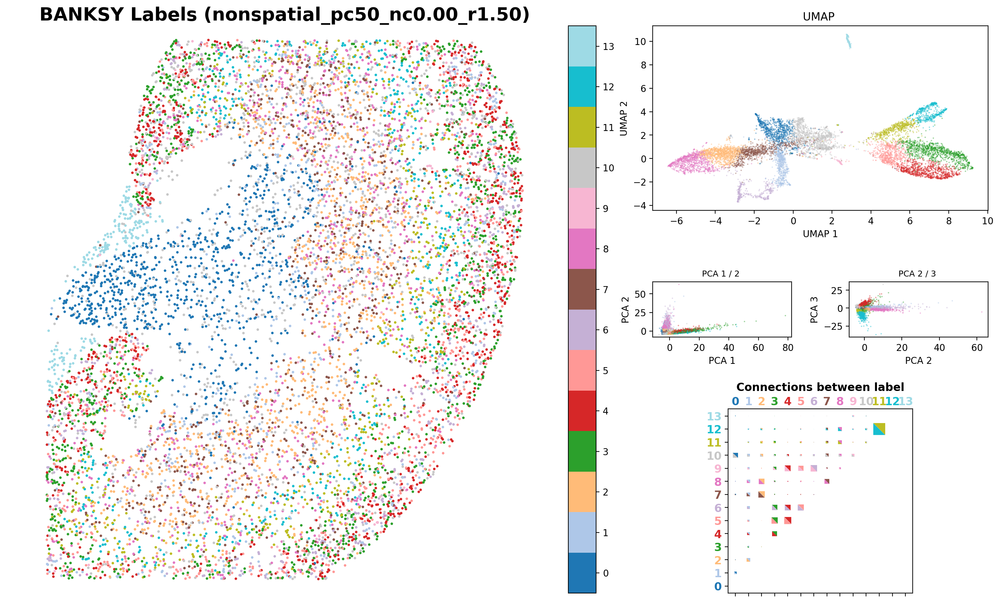

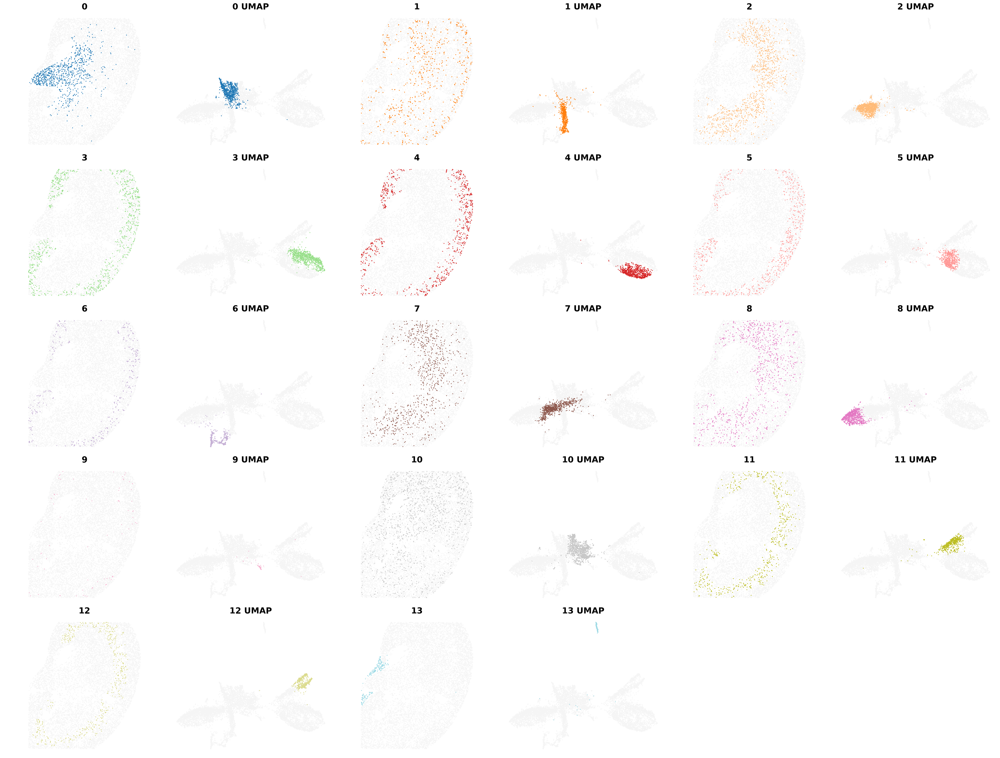

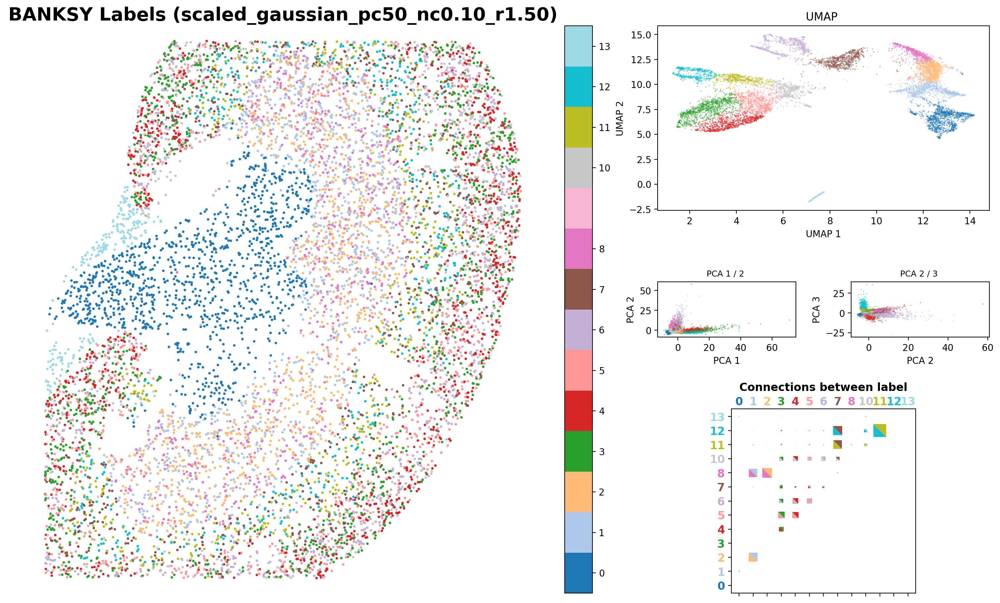

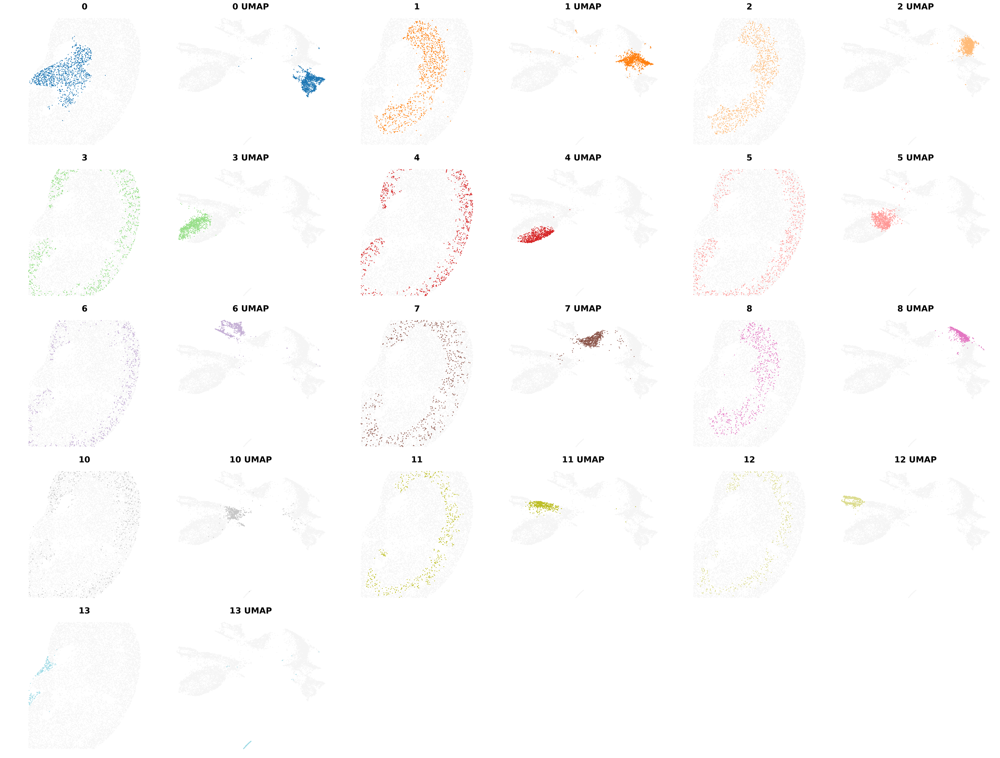

In [21]:
from banksy.plot_banksy import plot_results

c_map =  'tab20' # specify color map
weights_graph =  banksy_dict['scaled_gaussian']['weights'][0]

plot_results(
    results_df,
    weights_graph,
    c_map,
    match_labels = True,
    coord_keys = ('x', 'y', 'spatial'),
    max_num_labels  =  max_num_labels, 
    save_path = '/tmp',
    save_fig = False
)

In [22]:
results_df.iloc[1].adata.obs

,ct3,cell_type,x,y,labels_scaled_gaussian_pc50_nc0.10_r1.50
ID_167606,Mac_4,Myeloid,20646.342233,13577.402528,11
ID_103875,Epithelial_TALH_0,Epithelial,15934.699117,8659.666685,8
ID_276156,Perictye,Mesenchymal_Stromal,26279.892415,19862.586445,5
ID_169310,Fibroblast_Mfap5+,Mesenchymal_Stromal,22664.227129,12878.601577,5
ID_341987,Endothelial_Capilary,Endothelial,17493.253225,25774.605610,11
...,...,...,...,...,...
ID_70566,S1/S2/S3-PCT_Brush-Border_0,Epithelial,18518.904565,4149.601256,4
ID_326001,NK_0,NK,12776.800105,24642.684038,10
ID_314503,VSMC_AA,Mesenchymal_Stromal,26142.238248,21763.799487,5
ID_255802,Mesangial,Mesenchymal_Stromal,18995.839420,18384.630340,2


In [23]:
# label = 'scaled_gaussian_pc50_nc0.20_r0.60'
# label = 'scaled_gaussian_pc50_nc0.20_r1.00'
label = 'scaled_gaussian_pc50_nc0.10_r1.50'


In [24]:
results_df.loc[label].adata.obs

,ct3,cell_type,x,y,labels_scaled_gaussian_pc50_nc0.10_r1.50
ID_167606,Mac_4,Myeloid,20646.342233,13577.402528,11
ID_103875,Epithelial_TALH_0,Epithelial,15934.699117,8659.666685,8
ID_276156,Perictye,Mesenchymal_Stromal,26279.892415,19862.586445,5
ID_169310,Fibroblast_Mfap5+,Mesenchymal_Stromal,22664.227129,12878.601577,5
ID_341987,Endothelial_Capilary,Endothelial,17493.253225,25774.605610,11
...,...,...,...,...,...
ID_70566,S1/S2/S3-PCT_Brush-Border_0,Epithelial,18518.904565,4149.601256,4
ID_326001,NK_0,NK,12776.800105,24642.684038,10
ID_314503,VSMC_AA,Mesenchymal_Stromal,26142.238248,21763.799487,5
ID_255802,Mesangial,Mesenchymal_Stromal,18995.839420,18384.630340,2


In [25]:
adata.obs['banksy_cluster'] = results_df.loc[label].adata.obs[f'labels_{label}']

In [26]:
ref_adata = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_13.h5ad')
matching = pd.read_csv('matching_slat.csv', index_col=0)
matching = matching.loc[adata.obs_names]

adata.obs['ref_ct3'] = matching['reference_cell'].map(ref_adata.obs['ct3'])
adata.obs['ref_cell_type'] = matching['reference_cell'].map(ref_adata.obs['cell_type'])

In [27]:
banksy_dict['scaled_gaussian'].keys()

dict_keys(['weights', 'norm_counts_concatenated', 0.1])

In [28]:
umap_coords = banksy_dict['scaled_gaussian'][0.1]['adata'].obsm['reduced_pc_50_umap']

In [29]:
adata.obs['x_umap'] = umap_coords[:, 0]
adata.obs['y_umap'] = umap_coords[:, 1]

adata.obs.to_csv('banksy_subsampled.csv')
adata.obs

,ct3,cell_type,x,y,banksy_cluster,ref_ct3,ref_cell_type,x_umap,y_umap
ID_167606,Mac_4,Myeloid,20646.342233,13577.402528,11,Mac_2,Myeloid,4.125597,10.845884
ID_103875,Epithelial_TALH_0,Epithelial,15934.699117,8659.666685,8,Mac_0,Myeloid,11.540658,13.369151
ID_276156,Perictye,Mesenchymal_Stromal,26279.892415,19862.586445,5,Mac_3_TGFB3+,Myeloid,4.744831,7.484254
ID_169310,Fibroblast_Mfap5+,Mesenchymal_Stromal,22664.227129,12878.601577,5,Mac_0,Myeloid,5.019075,8.486723
ID_341987,Endothelial_Capilary,Endothelial,17493.253225,25774.605610,11,Endothelial_Capilary,Endothelial,5.212160,10.058126
...,...,...,...,...,...,...,...,...,...
ID_70566,S1/S2/S3-PCT_Brush-Border_0,Epithelial,18518.904565,4149.601256,4,Mac_0,Myeloid,3.867774,5.849139
ID_326001,NK_0,NK,12776.800105,24642.684038,10,NK_0,NK,6.162961,9.942794
ID_314503,VSMC_AA,Mesenchymal_Stromal,26142.238248,21763.799487,5,Mac_2,Myeloid,5.224092,8.074870
ID_255802,Mesangial,Mesenchymal_Stromal,18995.839420,18384.630340,2,Mac_0,Myeloid,12.297919,10.430603


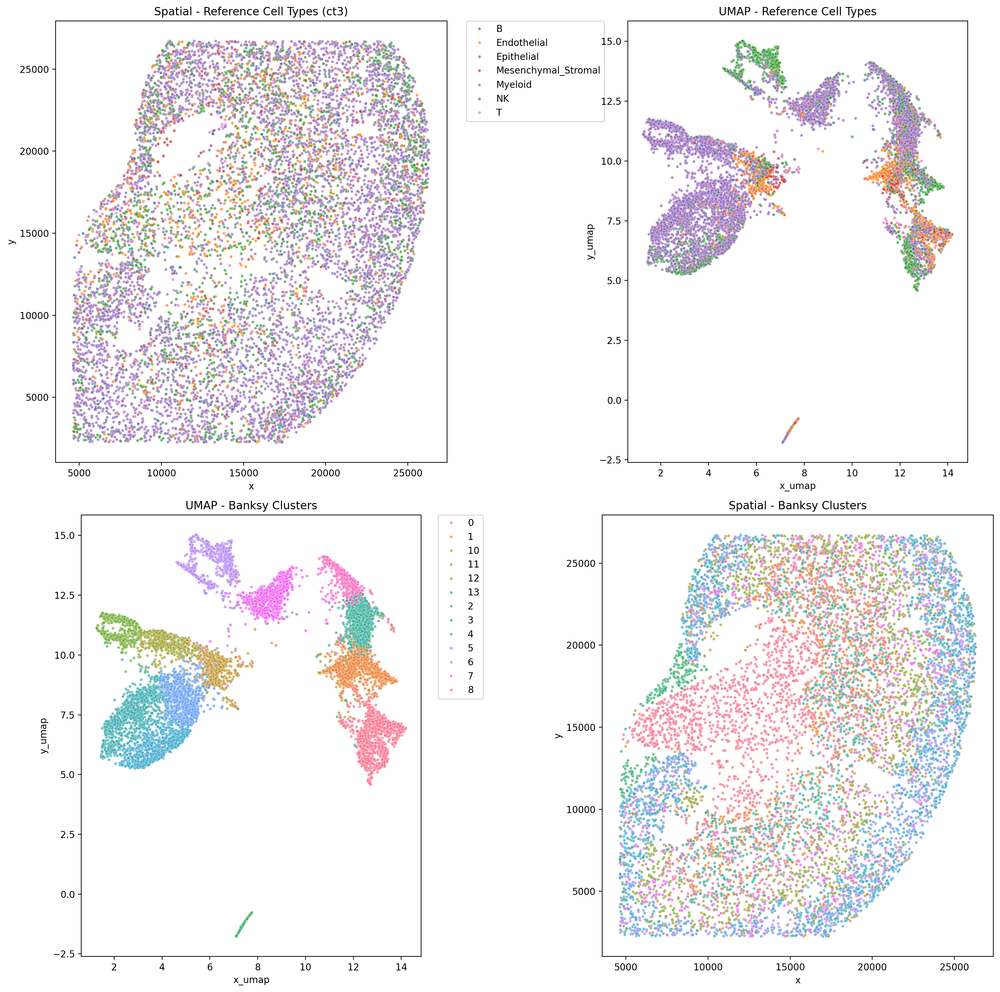

In [30]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 15))

# Plot 1: Spatial coordinates colored by ref_ct3
sns.scatterplot(
    data=adata.obs,
    x='x', y='y',
    hue='ref_cell_type',
    s=10,
    alpha=0.7,
    ax=ax1
)
ax1.set_title('Spatial - Reference Cell Types (ct3)')
ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
ax1.set_aspect('equal')

# Plot 2: Spatial coordinates colored by ref_cell_type  
sns.scatterplot(
    data=adata.obs,
    x='x_umap', y='y_umap', 
    hue='ref_cell_type',
    s=10,
    alpha=0.7,
    ax=ax2,
    legend=False
)
ax2.set_title('UMAP - Reference Cell Types')
ax2.set_aspect('equal')

# Plot 3: UMAP coordinates colored by banksy clusters
sns.scatterplot(
    data=adata.obs,
    x='x_umap', y='y_umap',
    hue='banksy_cluster',
    s=10,
    alpha=0.7,
    ax=ax3
)
ax3.set_title('UMAP - Banksy Clusters')
ax3.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
ax3.set_aspect('equal')

# Plot 4: Spatial coordinates colored by banksy clusters
sns.scatterplot(
    data=adata.obs,
    x='x', y='y',
    hue='banksy_cluster', 
    s=10,
    alpha=0.7,
    ax=ax4,
    legend=False
)
ax4.set_title('Spatial - Banksy Clusters')
ax4.set_aspect('equal')

plt.tight_layout()


In [31]:
# Find highly variable genes between Banksy clusters
adata.X = adata.layers['normalized_count']
sc.tl.rank_genes_groups(adata, 'banksy_cluster', method='wilcoxon')

# Get top 10 genes for each cluster
top_genes_df = pd.DataFrame({
    group + '_cluster': [gene for gene in adata.uns['rank_genes_groups']['names'][group][:10]]
    for group in adata.uns['rank_genes_groups']['names'].dtype.names
})

top_genes_df[sorted(top_genes_df.columns)]



,0_cluster,10_cluster,11_cluster,12_cluster,13_cluster,1_cluster,2_cluster,3_cluster,4_cluster,5_cluster,6_cluster,7_cluster,8_cluster
0,Akr1b3,Tmsb4x,Kap,Slc27a2,Scd1,Igfbp5,Umod,Kap,Gpx3,Gpx3,S100g,Umod,Umod
1,Cryab,Igfbp3,Slc27a2,Kap,Fabp4,Tmsb4x,Fxyd2,Slc34a1,Slc34a1,Slc34a1,Calb1,Egf,Fxyd2
2,Tmsb4x,Sparc,Ghr,Ghr,Lpl,Igfbp7,Slc12a1,Pck1,Miox,Aldob,Defb1,Slc12a1,Slc12a1
3,Igfbp5,Gpx3,Chpt1,Napsa,Gpd1,Hsd11b2,Atp1a1,Slc27a2,Aldob,Kap,Slc12a3,Wfdc15b,Wfdc15b
4,Sgk1,Mgp,Napsa,Chpt1,Dgat2,Apela,Atp1b1,Cyp4b1,Ass1,Miox,Slc8a1,Atp1a1,Atp1a1
5,Mal,Bgn,Cyp7b1,Slc6a18,Pck1,Aqp2,Wfdc15b,Gpx3,Slc5a2,Ass1,Tmem52b,Ppp1r1a,Plau
6,Aqp2,Ccn2,Mpv17l,Mpv17l,Cd36,Rasgef1b,Slc5a3,Acsm2,Gatm,Acsm2,Klk1,Ly6a,Ppp1r1a
7,Aqp4,Col4a1,Slc6a18,Cyp7b1,Apoe,Cxcl12,Ppp1r1a,Odc1,Slc5a12,Pck1,Atp1a1,Atp1b1,Atp1b1
8,Igfbp7,Timp3,Mep1a,Mep1a,Cebpb,Tinagl1,Plau,Miox,Igfbp4,Lrp2,Clu,Nudt4,Slc5a3
9,Nupr1,Fbln5,Crot,Mat2a,G0s2,Ranbp3l,Egf,Lrp2,Cltrn,Odc1,Tmem213,Klk1,Egf


In [32]:
import json

cluster_annotations = {
    "0": "Proximal Tubule (PT)",
    "1": "Proximal Tubule (PT)",
    "2": "Thick Ascending Limb (TAL)",
    "3": "Proximal Tubule / DCT",
    "4": "Proximal Tubule (PT)",
    "5": "Distal Convoluted Tubule (DCT) / CNT",
    "6": "Connecting Tubule / Collecting Duct (CD)",
    "7": "Collecting Duct (CD) / Intercalated Cells",
    "8": "Immune-like / Proximal Tubule",
    "9": "Immune / Macrophage-like Cells",
    "10": "Stressed Proximal Tubule / Injury-Associated",
    "11": "Proximal Tubule / CNT",
    "12": "Distal Convoluted Tubule (DCT) / CNT",
    "13": "Lipid-Associated Macrophages / Stromal-like"
}

with open('banksy_subsampled.json', 'w') as f:
    json.dump(cluster_annotations, f)

In [ ]:
plt.rcParams['figure.figsize'] = (5, 5)
plt.rcParams['figure.dpi'] = 120
# label = 'labels_scaled_gaussian_pc50_nc0.20_r0.90'
sns.scatterplot(
    data=adata.obs, 
    x='x', y='y', hue='banksy_cluster', s=10, 
    legend=False, palette='tab20', alpha=0.1)

sns.scatterplot(
    # data=adata.obs[adata.obs.cell_type.isin(['Myeloid'])], 
    data=adata.obs[adata.obs['ref_ct3'].isin(['Mac_0'])],
    x='x', y='y', hue='banksy_cluster', s=10, linewidth=0.25, edgecolor='black',
    legend=True, palette='tab20')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

In [33]:
tmp = results_df.iloc[1].adata

In [34]:
matching = pd.read_csv('matching_slat.csv', index_col=0)
matching = matching.loc[tmp.obs_names]

tmp.obs['ref_ct3'] = matching['reference_cell'].map(ref_adata.obs['ct3'])
tmp.obs['ref_cell_type'] = matching['reference_cell'].map(ref_adata.obs['cell_type'])

In [35]:
# label = 'labels_scaled_gaussian_pc50_nc0.20_r0.60'

# fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

# ax1.scatter(
#     tmp.obs['x'],
#     tmp.obs['y'],
#     c='grey',
#     s=10,
#     alpha=0.1
# )
# ax2.scatter(
#     tmp.obs['x'],
#     tmp.obs['y'],
#     c='grey',
#     s=10,
#     alpha=0.1
# )

# # Plot Mac_0
# mask_mac0 = tmp.obs['ref_ct3'] == 'Mac_0'
# ax1.scatter(
#     tmp[mask_mac0].obs['x'],
#     tmp[mask_mac0].obs['y'], 
#     c=tmp[mask_mac0].obs[label].astype(int),
#     cmap='tab20',
#     s=10,
#     alpha=0.9
# )
# ax1.set_title('Mac_0')

# # Plot Mac_2
# mask_mac2 = tmp.obs['ref_ct3'] == 'Mac_2'
# ax2.scatter(
#     tmp[mask_mac2].obs['x'],
#     tmp[mask_mac2].obs['y'],
#     c=tmp[mask_mac2].obs[label].astype(int), 
#     cmap='tab20',
#     s=10,
#     alpha=0.9
# )
# ax2.set_title('Mac_2')
